In [1]:
from drone_detector.imports import *
from drone_detector.engines.detectron2.tta import *
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data.datasets import register_coco_instances
from detectron2.data import build_detection_test_loader, DatasetCatalog, MetadataCatalog
from detectron2.evaluation  import COCOEvaluator, DatasetEvaluators, inference_on_dataset
import cv2
import matplotlib.pyplot as plt
import torch

# Validation set results

In [2]:
datapath = Path('../../data/processed/hiidenportti/')
register_coco_instances('hiidenportti_val', {}, datapath/'hiidenportti_valid.json', datapath/'valid_512')

In [3]:
cfg = get_cfg()
cfg.merge_from_file('../models/hiidenportti/mask_rcnn_X_101_32x8d_FPN_3x/config.yaml')
cfg.DEVICE = f'cuda:{torch.cuda.current_device()}'
cfg.OUTPUT_DIR = '../models/hiidenportti/mask_rcnn_X_101_32x8d_FPN_3x//'
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, 'model_final.pth')
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
predictor = DefaultPredictor(cfg)

In [4]:
evaluator = COCOEvaluator('hiidenportti_val', output_dir=cfg.OUTPUT_DIR)
val_loader = build_detection_test_loader(cfg, 'hiidenportti_val')
print(inference_on_dataset(predictor.model, val_loader, evaluator))

/opt/conda/lib/python3.9/site-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/opt/conda/lib/python3.9/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.304
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.572
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.303
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.258
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.217
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.213
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.427
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.433
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.345
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.398
 Average Recall     (AR) @[ IoU=0.50:0

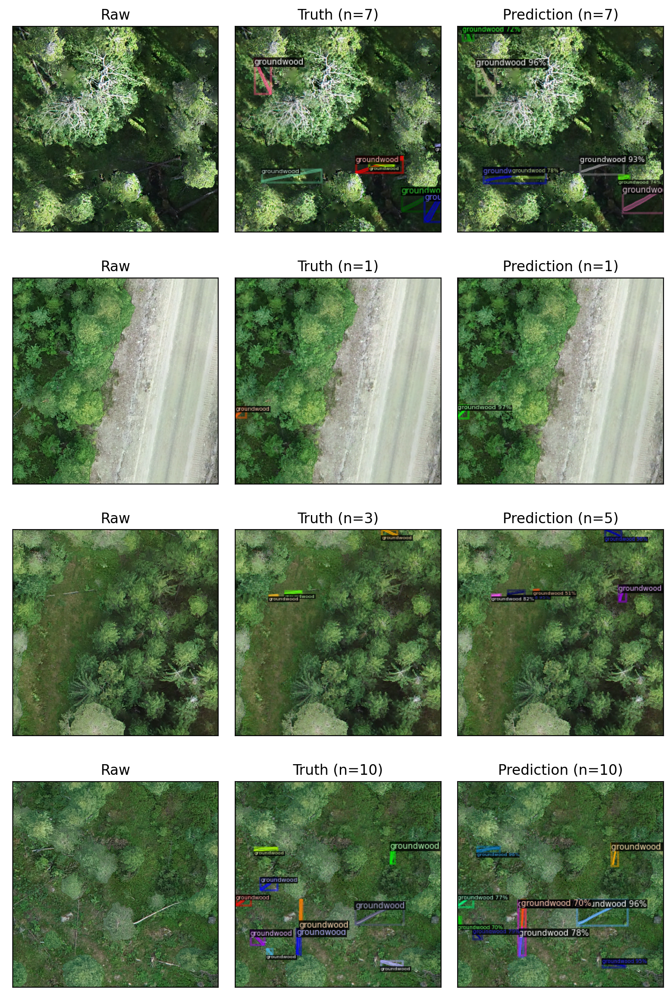

In [5]:
dataset_dicts = DatasetCatalog.get('hiidenportti_val')
fig, axs = plt.subplots(4,3, dpi=200, figsize=(8,12))
ddicts = random.sample(dataset_dicts, 4)
for d, i in zip(ddicts, range(0,4)):
    axs[i,0].set_xticks([])
    axs[i,0].set_yticks([])
    axs[i,1].set_xticks([])
    axs[i,1].set_yticks([])
    axs[i,2].set_xticks([])
    axs[i,2].set_yticks([])
    img = cv2.imread(d["file_name"])
    axs[i,0].imshow(np.dstack((img[...,2],img[...,1], img[...,0])))
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('hiidenportti_val'), scale=.5)
    truth = visualizer.draw_dataset_dict(d)
    axs[i,1].imshow(truth.get_image()[...,::-1][...,::-1])
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('hiidenportti_val'), scale=.5)
    preds = predictor(img[...,::-1])
    pred = visualizer.draw_instance_predictions(preds["instances"].to("cpu"))
    axs[i,2].imshow(pred.get_image()[...,::-1][...,::-1])
    axs[i,0].set_title('Raw')
    axs[i,1].set_title(f'Truth (n={len(d["annotations"])})')
    axs[i,2].set_title(f'Prediction (n={len(preds["instances"])})')
plt.tight_layout()

In [6]:
cfg.TEST.AUG.MIN_SIZES = (cfg.INPUT.MIN_SIZE_TEST-200, cfg.INPUT.MIN_SIZE_TEST, cfg.INPUT.MIN_SIZE_TEST+200,)
tta_predictor = TTAPredictor(cfg)

In [7]:
evaluator = COCOEvaluator('hiidenportti_val', output_dir=cfg.OUTPUT_DIR)
val_loader = build_detection_test_loader(cfg, 'hiidenportti_val')
print(inference_on_dataset(tta_predictor.model, val_loader, evaluator))

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.638
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.294
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.306
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.219
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.216
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.465
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.482
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.459
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.446
 Average Recall     (AR) @[ IoU=0.50:0

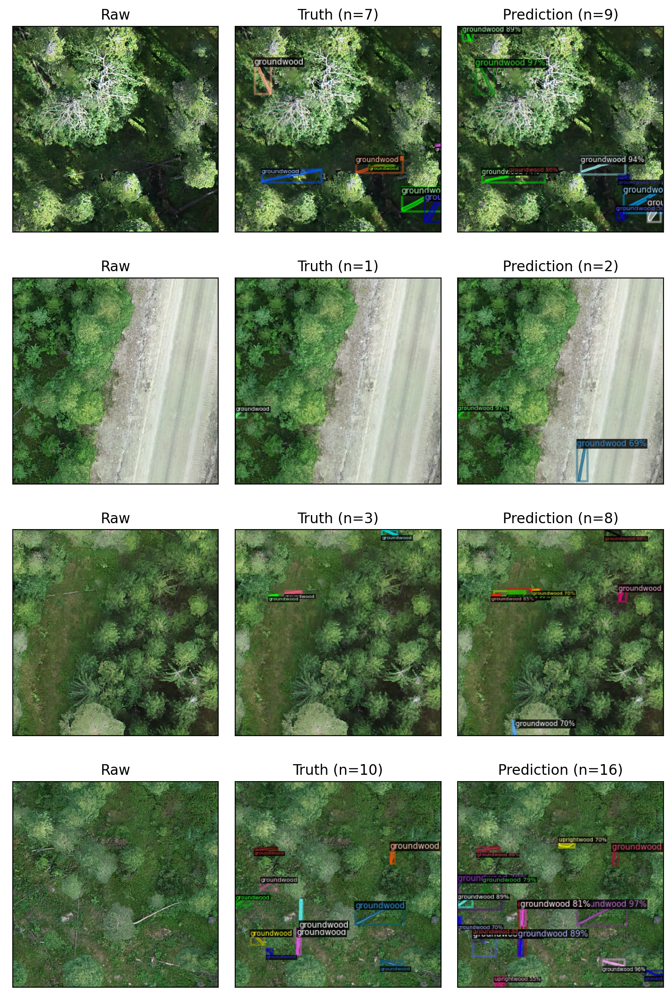

In [8]:
fig, axs = plt.subplots(4,3, dpi=200, figsize=(8,12))
for d, i in zip(ddicts, range(0,4)):
    axs[i,0].set_xticks([])
    axs[i,0].set_yticks([])
    axs[i,1].set_xticks([])
    axs[i,1].set_yticks([])
    axs[i,2].set_xticks([])
    axs[i,2].set_yticks([])
    img = cv2.imread(d["file_name"])
    axs[i,0].imshow(np.dstack((img[...,2],img[...,1], img[...,0])))
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('hiidenportti_val'), scale=.5)
    truth = visualizer.draw_dataset_dict(d)
    axs[i,1].imshow(truth.get_image()[...,::-1][...,::-1])
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('hiidenportti_val'), scale=.5)
    preds = tta_predictor(img[...,::-1])
    pred = visualizer.draw_instance_predictions(preds["instances"].to("cpu"))
    axs[i,2].imshow(pred.get_image()[...,::-1][...,::-1])
    axs[i,0].set_title('Raw')
    axs[i,1].set_title(f'Truth (n={len(d["annotations"])})')
    axs[i,2].set_title(f'Prediction (n={len(preds["instances"])})')
plt.tight_layout()

# Test set results

## Image patches

In [9]:
register_coco_instances('hiidenportti_test', {}, datapath/'hiidenportti_test.json', datapath/'test_512')

In [10]:
evaluator = COCOEvaluator('hiidenportti_test', output_dir=cfg.OUTPUT_DIR)
val_loader = build_detection_test_loader(cfg, "hiidenportti_test")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.355
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.631
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.357
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.346
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.264
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.151
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.435
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.463
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.409
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.533
 Average Recall     (AR) @[ IoU=0.50:0

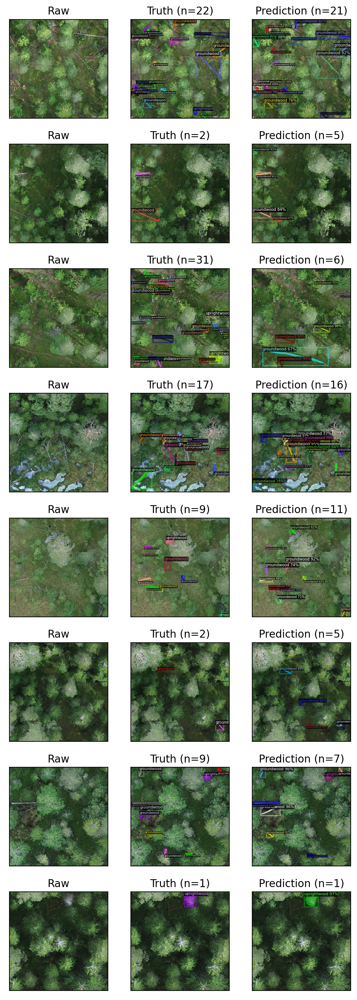

In [11]:
dataset_dicts = DatasetCatalog.get('hiidenportti_test')
fig, axs = plt.subplots(8,3, dpi=200, figsize=(6,16))
ddicts = random.sample(dataset_dicts, 8)
for d, i in zip(ddicts, range(0,8)):
    axs[i,0].set_xticks([])
    axs[i,0].set_yticks([])
    axs[i,1].set_xticks([])
    axs[i,1].set_yticks([])
    axs[i,2].set_xticks([])
    axs[i,2].set_yticks([])
    img = cv2.imread(d["file_name"])
    axs[i,0].imshow(np.dstack((img[...,2],img[...,1], img[...,0])))
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('hiidenportti_test'), scale=.5)
    truth = visualizer.draw_dataset_dict(d)
    axs[i,1].imshow(truth.get_image()[...,::-1][...,::-1])
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('hiidenportti_test'), scale=.5)
    preds = predictor(img[...,::-1])
    pred = visualizer.draw_instance_predictions(preds["instances"].to("cpu"))
    axs[i,2].imshow(pred.get_image()[...,::-1][...,::-1])
    axs[i,0].set_title('Raw')
    axs[i,1].set_title(f'Truth (n={len(d["annotations"])})')
    axs[i,2].set_title(f'Prediction (n={len(preds["instances"])})')
plt.tight_layout()

### TTA

In [12]:
evaluator = COCOEvaluator("hiidenportti_test", output_dir=cfg.OUTPUT_DIR, max_dets_per_image=100, use_fast_impl=False)
print(inference_on_dataset(tta_predictor.model, val_loader, evaluator))

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.47s).
Accumulating evaluation results...
DONE (t=0.04s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.377
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.689
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.357
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.391
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.272
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.152
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.471
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.515
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

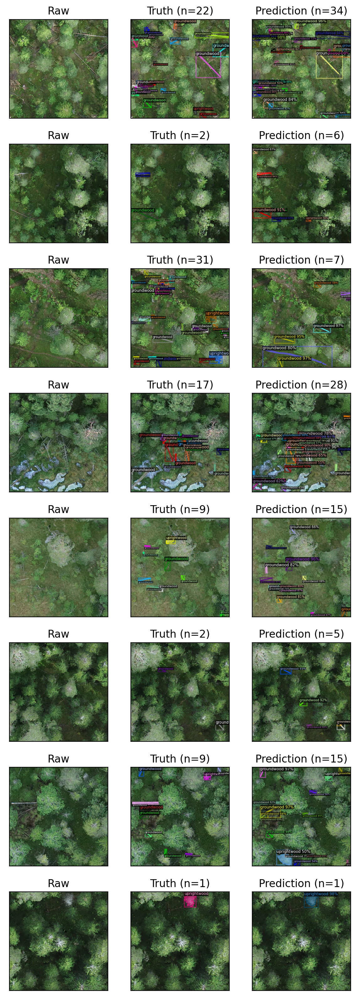

In [13]:
fig, axs = plt.subplots(8,3, dpi=200, figsize=(6,16))
for d, i in zip(ddicts, range(0,8)):
    axs[i,0].set_xticks([])
    axs[i,0].set_yticks([])
    axs[i,1].set_xticks([])
    axs[i,1].set_yticks([])
    axs[i,2].set_xticks([])
    axs[i,2].set_yticks([])
    img = cv2.imread(d["file_name"])
    axs[i,0].imshow(np.dstack((img[...,2],img[...,1], img[...,0])))
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('hiidenportti_test'), scale=.5)
    truth = visualizer.draw_dataset_dict(d)
    axs[i,1].imshow(truth.get_image()[...,::-1][...,::-1])
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('hiidenportti_test'), scale=.5)
    preds = tta_predictor(img[...,::-1])
    pred = visualizer.draw_instance_predictions(preds["instances"].to("cpu"))
    axs[i,2].imshow(pred.get_image()[...,::-1][...,::-1])
    axs[i,0].set_title('Raw')
    axs[i,1].set_title(f'Truth (n={len(d["annotations"])})')
    axs[i,2].set_title(f'Prediction (n={len(preds["instances"])})')
plt.tight_layout()

# Evo results

In [37]:
# Combine several coco-annotation .json files into one

import json

full_coco = None
image_id_modifier = 0
ann_id_modifier = 0
spk_path = Path('../../data/processed/sudenpesankangas/')
files = ['sudenpesankangas_test.json', 'sudenpesankangas_train.json', 'sudenpesankangas_valid.json']
folders = ['test_512', 'train_512', 'valid_512']
for p, fol in zip(files, folders):
    with open(spk_path/p) as f:
        coco = json.load(f)
    
    # update filename
    for i in coco['images']:
        i['file_name'] = f"{fol}/{i['file_name']}"
        
    if full_coco is None: 
        full_coco = coco
        image_id_modifier = full_coco['images'][-1]['id']
        ann_id_modifier = full_coco['annotations'][-1]['id']
    else:
        for i in coco['images']:
            i['id'] += image_id_modifier
        for a in coco['annotations']:
            a['image_id'] += image_id_modifier
            a['id'] += ann_id_modifier
        
        full_coco['images'].extend(coco['images'])
        full_coco['annotations'].extend(coco['annotations'])
        image_id_modifier = full_coco['images'][-1]['id'] + 1
        ann_id_modifier = full_coco['annotations'][-1]['id'] + 1
        
with open(spk_path/'sudenpesankangas_all.json', 'w') as outfile: json.dump(full_coco, outfile)

## Image patches

In [38]:
datapath = Path('../../data/processed/sudenpesankangas/')
register_coco_instances('sudenpesankangas_all', {}, datapath/'sudenpesankangas_all.json', datapath)

In [40]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("sudenpesankangas_all", output_dir=cfg.OUTPUT_DIR, max_dets_per_image=100, use_fast_impl=True)
val_loader = build_detection_test_loader(cfg, "sudenpesankangas_all")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

/opt/conda/lib/python3.9/site-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.257
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.443
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.271
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.196
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.271
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.277
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.125
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.300
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.229
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.477
 Average Recall     (AR) @[ IoU=0.50:0.

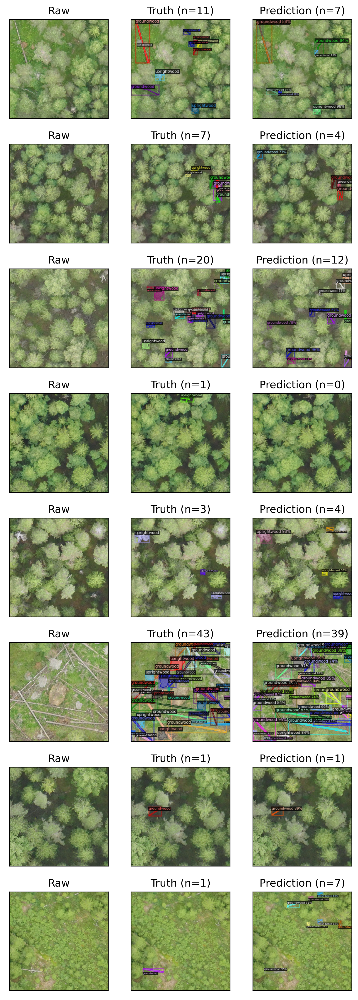

In [43]:
dataset_dicts = DatasetCatalog.get('sudenpesankangas_all')
ddicts = random.sample(dataset_dicts, 8)
fig, axs = plt.subplots(8,3, dpi=300, figsize=(6,16))
for d, i in zip(ddicts, range(0,8)):
    axs[i,0].set_xticks([])
    axs[i,0].set_yticks([])
    axs[i,1].set_xticks([])
    axs[i,1].set_yticks([])
    axs[i,2].set_xticks([])
    axs[i,2].set_yticks([])
    img = cv2.imread(d["file_name"])
    axs[i,0].imshow(np.dstack((img[...,2],img[...,1], img[...,0])))
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('sudenpesankangas_all'), scale=.5)
    truth = visualizer.draw_dataset_dict(d)
    axs[i,1].imshow(truth.get_image()[...,::-1][...,::-1])
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('sudenpesankangas_all'), scale=.5)
    preds = predictor(img[...,::-1])
    pred = visualizer.draw_instance_predictions(preds["instances"].to("cpu"))
    axs[i,2].imshow(pred.get_image()[...,::-1][...,::-1])
    axs[i,0].set_title('Raw')
    axs[i,1].set_title(f'Truth (n={len(d["annotations"])})')
    axs[i,2].set_title(f'Prediction (n={len(preds["instances"])})')
plt.tight_layout()

### TTA

In [44]:
print(inference_on_dataset(tta_predictor.model, val_loader, evaluator))

Loading and preparing results...
DONE (t=0.01s)
creating index...
index created!
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.545
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.253
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.310
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.416
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.139
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.370
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.423
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.340
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.533
 Average Recall     (AR) @[ IoU=0.50:0.

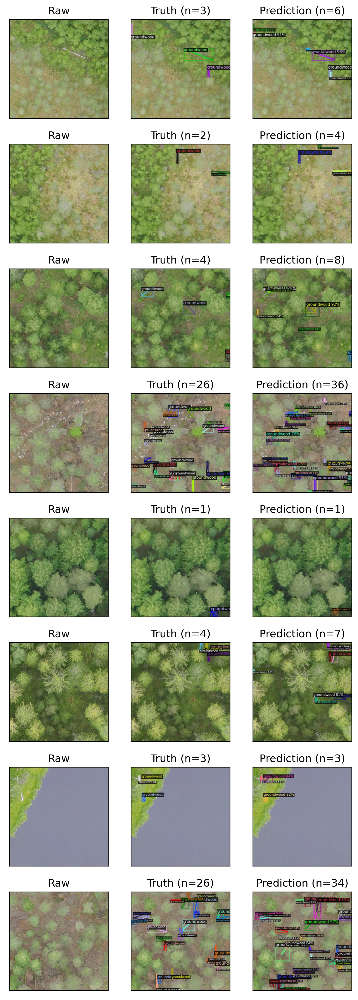

In [416]:
fig, axs = plt.subplots(8,3, dpi=300, figsize=(6,16))
for d, i in zip(ddicts, range(0,8)):
    axs[i,0].set_xticks([])
    axs[i,0].set_yticks([])
    axs[i,1].set_xticks([])
    axs[i,1].set_yticks([])
    axs[i,2].set_xticks([])
    axs[i,2].set_yticks([])
    img = cv2.imread(d["file_name"])
    axs[i,0].imshow(np.dstack((img[...,2],img[...,1], img[...,0])))
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('sudenpesankangas_test'), scale=.5)
    truth = visualizer.draw_dataset_dict(d)
    axs[i,1].imshow(truth.get_image()[...,::-1][...,::-1])
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('sudenpesankangas_test'), scale=.5)
    preds = tta_predictor(img[...,::-1])
    pred = visualizer.draw_instance_predictions(preds["instances"].to("cpu"))
    axs[i,2].imshow(pred.get_image()[...,::-1][...,::-1])
    axs[i,0].set_title('Raw')
    axs[i,1].set_title(f'Truth (n={len(d["annotations"])})')
    axs[i,2].set_title(f'Prediction (n={len(preds["instances"])})')
plt.tight_layout()